# Example Notebook

In [1]:
from pynwb import NWBHDF5IO
import numpy as np
import matplotlib.pyplot as plt
from bisect import bisect_left

This notebook showcases the two example sessions from the Corredera 2025 dataset containing exploratory behavior, audiovisual stimulus, and concurrent WhiteMatter recordings in auditory cortex.

## Audio-only Example Session

In [2]:
nwbfile_path = "/Volumes/T7/CatalystNeuro/Schneider/conversion_nwb/corredera_2025/sub-m14_pb_ses-2024-12-12.nwb"
with NWBHDF5IO(nwbfile_path, 'r') as io:
    nwbfile = io.read()
    display(nwbfile)

Data type,float32
Shape,"(813368833, 4)"
Array size,12.12 GiB
Chunk shape,"(1581, 4)"
Compression,gzip
Compression opts,4
Compression ratio,1.605462350851699
Data type,float64
Shape,"(813368833,)"
Array size,6.06 GiB
Chunk shape,"(1250000,)"


Retrieve Audio Recording, Audio Stimulus, Ephys recording and sorting, and Pose Estimation

In [3]:
with NWBHDF5IO(nwbfile_path, 'r') as io:
    nwbfile = io.read()

    # Ephys Recording
    raw_electrical_series = nwbfile.acquisition["ElectricalSeriesRaw"]
    raw_starting_time = raw_electrical_series.starting_time
    plot_start_time = raw_starting_time
    plot_stop_time = raw_starting_time + 1  # Plot for 1 second
    raw_fs = raw_electrical_series.rate
    raw_to_uV = raw_electrical_series.conversion * 1e6
    raw_electrical_series_in_uV = raw_electrical_series.data[:int(raw_fs), 0] * raw_to_uV
    raw_electrical_series_timestamps = np.arange(0, len(raw_electrical_series_in_uV)) / raw_fs + raw_starting_time
    processed_electrical_series = nwbfile.processing["ecephys"].data_interfaces["Processed"].electrical_series["ElectricalSeriesProcessed"]
    processed_electrical_series_starting_time = processed_electrical_series.starting_time
    processed_fs = processed_electrical_series.rate
    processed_to_uV = processed_electrical_series.conversion * 1e6
    processed_electrical_series_in_uV = processed_electrical_series.data[:int(processed_fs), 0] * processed_to_uV
    processed_electrical_series_timestamps = np.arange(0, len(processed_electrical_series_in_uV)) / processed_fs + processed_electrical_series_starting_time

    # Ephys Sorting
    units_df = nwbfile.units.to_dataframe()
    units_df_good = units_df[(units_df['quality'] == 'good') & (units_df["KSLabel"] == "good")]
    units_df_ch13 = units_df_good[units_df_good['ch'] == 13]
    spike_times_per_unit = []
    for unit, row in units_df_ch13.iterrows():
        spike_times = row['spike_times'][(row['spike_times'] >= plot_start_time) & (row['spike_times'] < plot_stop_time)]
        spike_times_per_unit.append(spike_times)
    
    # Audio Recording
    audio_start_index = bisect_left(nwbfile.acquisition['AudioRecording'].timestamps, plot_start_time)
    audio_stop_index = bisect_left(nwbfile.acquisition['AudioRecording'].timestamps, plot_stop_time)
    audio_timestamps = nwbfile.acquisition['AudioRecording'].timestamps[audio_start_index:audio_stop_index]
    audio_data = nwbfile.acquisition['AudioRecording'].data[audio_start_index:audio_stop_index, :]

    # Audio Stimulus
    stimulus_1_data = nwbfile.stimulus_template["sound01_F2000_L65_D0.1+0.005"].data[:]
    stimulus_1_rate = nwbfile.stimulus_template["sound01_F2000_L65_D0.1+0.005"].rate
    stimulus_2_data = nwbfile.stimulus_template["sound02_F4000_L65_D0.1+0.005"].data[:]
    stimulus_2_rate = nwbfile.stimulus_template["sound02_F4000_L65_D0.1+0.005"].rate
    stimulus_3_data = nwbfile.stimulus_template["sound03_F6000_L65_D0.1+0.005"].data[:]
    stimulus_3_rate = nwbfile.stimulus_template["sound03_F6000_L65_D0.1+0.005"].rate
    audio_stimulus_df = nwbfile.stimulus["AudioStimulus"].to_dataframe()

    # Pose Estimation
    pose_estimation_series = nwbfile.processing["SLEAP_VIDEO_000_m14_pb_2024-12-12_001_CamFlir1_20241212_102813"].data_interfaces["track=untracked"].pose_estimation_series
    name_to_data = {name: series.data[:] for name, series in pose_estimation_series.items()}
    name_to_timestamps = {name: series.timestamps[:] for name, series in pose_estimation_series.items()}
    edges = nwbfile.processing["SLEAP_VIDEO_000_m14_pb_2024-12-12_001_CamFlir1_20241212_102813"].data_interfaces["track=untracked"].skeleton.edges[:]
    nodes = nwbfile.processing["SLEAP_VIDEO_000_m14_pb_2024-12-12_001_CamFlir1_20241212_102813"].data_interfaces["track=untracked"].skeleton.nodes[:]

Plot Ephys and Audio data

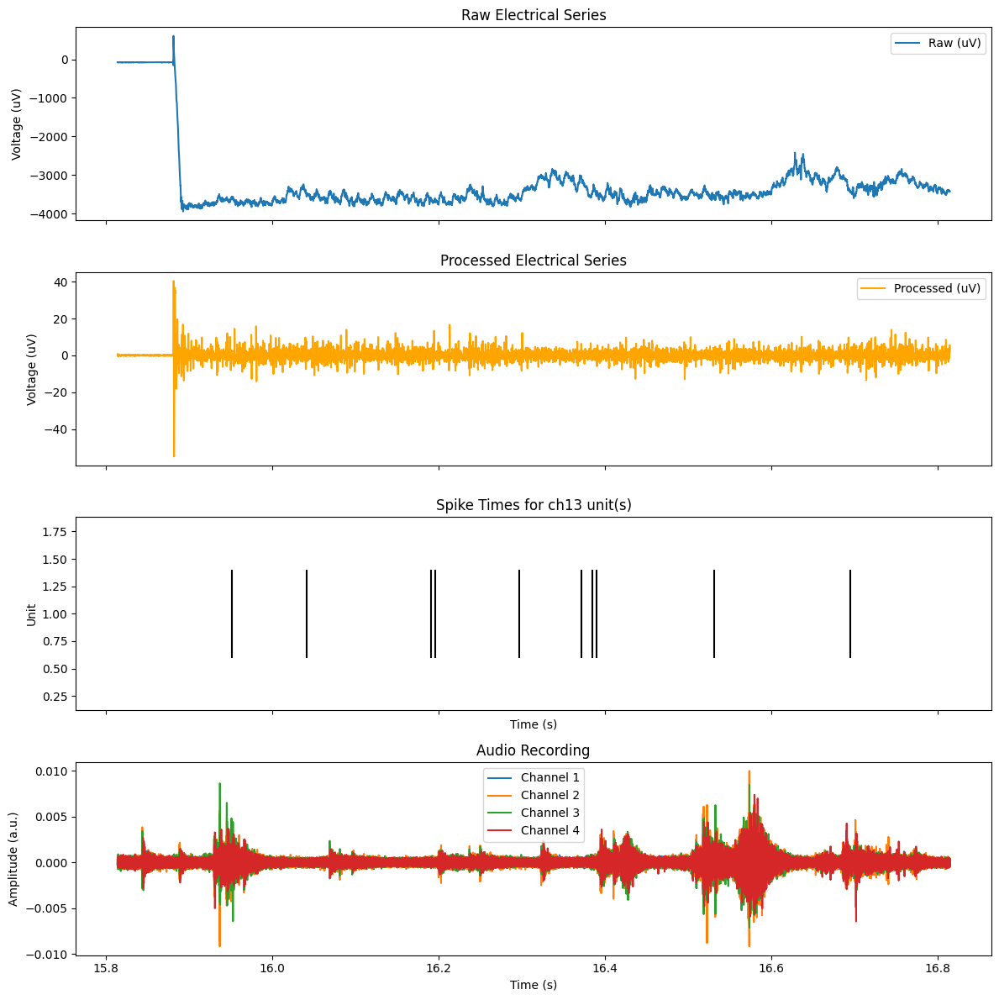

In [4]:
fig, axs = plt.subplots(4, 1, figsize=(12, 12), sharex=True)

axs[0].plot(raw_electrical_series_timestamps, raw_electrical_series_in_uV, label='Raw (uV)')
axs[0].set_ylabel('Voltage (uV)')
axs[0].set_title('Raw Electrical Series')
axs[0].legend()

axs[1].plot(processed_electrical_series_timestamps, processed_electrical_series_in_uV, label='Processed (uV)', color='orange')
axs[1].set_ylabel('Voltage (uV)')
axs[1].set_title('Processed Electrical Series')
axs[1].legend()

axs[2].eventplot(spike_times_per_unit, colors='k', linelengths=0.8)
axs[2].set_xlabel('Time (s)')
axs[2].set_ylabel('Unit')
axs[2].set_title('Spike Times for ch13 unit(s)')

for ch in range(audio_data.shape[1]):
    axs[3].plot(audio_timestamps, audio_data[:, ch], label=f"Channel {ch+1}")
axs[3].set_title('Audio Recording')
axs[3].set_xlabel('Time (s)')
axs[3].set_ylabel('Amplitude (a.u.)')
axs[3].legend()

plt.tight_layout()
plt.show()

Plot Audio Stimulus

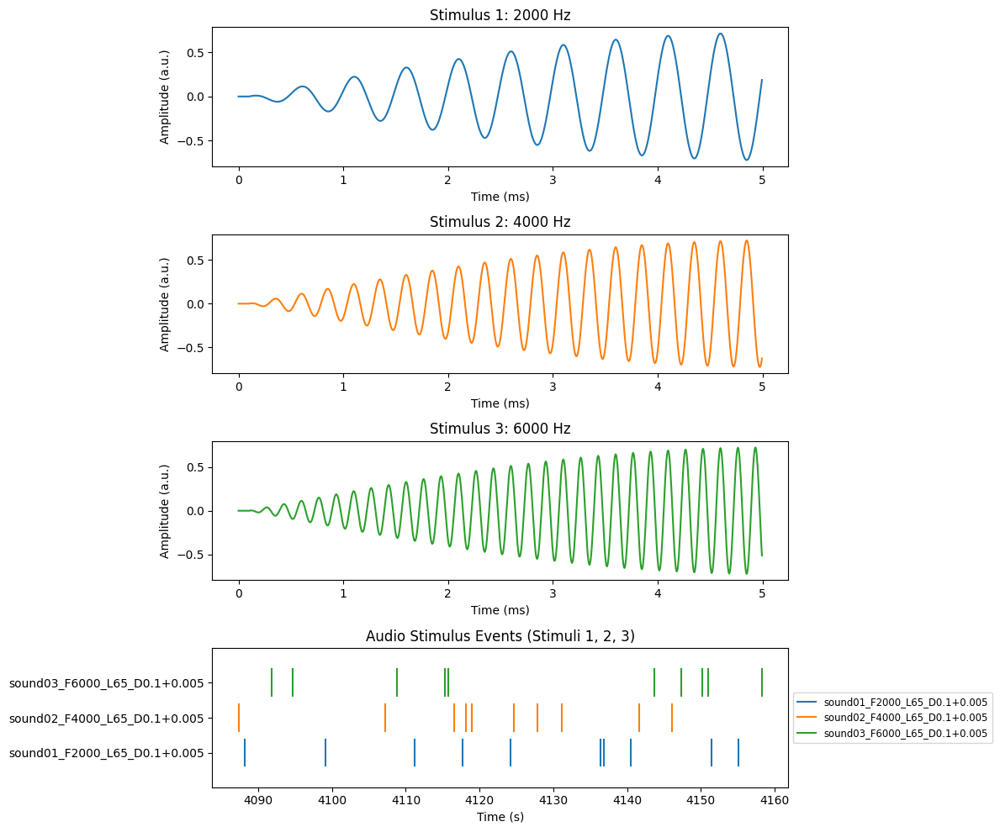

In [5]:
stimuli = [
    (stimulus_1_data, stimulus_1_rate, "Stimulus 1: 2000 Hz"),
    (stimulus_2_data, stimulus_2_rate, "Stimulus 2: 4000 Hz"),
    (stimulus_3_data, stimulus_3_rate, "Stimulus 3: 6000 Hz")
]

window_ms = 5  # milliseconds to display

# Use the same colors as the lower plot
colors = plt.cm.tab10.colors
stimulus_names_to_plot = [
    "sound01_F2000_L65_D0.1+0.005",
    "sound02_F4000_L65_D0.1+0.005",
    "sound03_F6000_L65_D0.1+0.005"
]
name_to_color = {name: colors[i % len(colors)] for i, name in enumerate(stimulus_names_to_plot)}

fig, axs = plt.subplots(4, 1, figsize=(12, 10), sharex=False)

# Plot the three stimulus waveforms
for ax, (data, rate, title), name in zip(axs[:3], stimuli, stimulus_names_to_plot):
    n_samples = int(window_ms * 1e-3 * rate)
    t = np.arange(n_samples) / rate
    ax.plot(t * 1e3, data[:n_samples], color=name_to_color[name])  # convert time to ms
    ax.set_title(title)
    ax.set_xlabel("Time (ms)")
    ax.set_ylabel("Amplitude (a.u.)")

# Plot event times from the audio stimulus table, but only for stimuli 1, 2, and 3
ax = axs[3]
for i, name in enumerate(stimulus_names_to_plot):
    times = audio_stimulus_df[audio_stimulus_df['stimulus_name'] == name]['presentation_time'].values
    ax.eventplot(times, lineoffsets=i, colors=[name_to_color[name]], linelengths=0.8, label=name)

ax.set_title("Audio Stimulus Events (Stimuli 1, 2, 3)")
ax.set_xlabel("Time (s)")
ax.set_yticks(range(len(stimulus_names_to_plot)))
ax.set_yticklabels(stimulus_names_to_plot)
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize='small')

plt.tight_layout()
plt.show()


Plot Pose Estimation

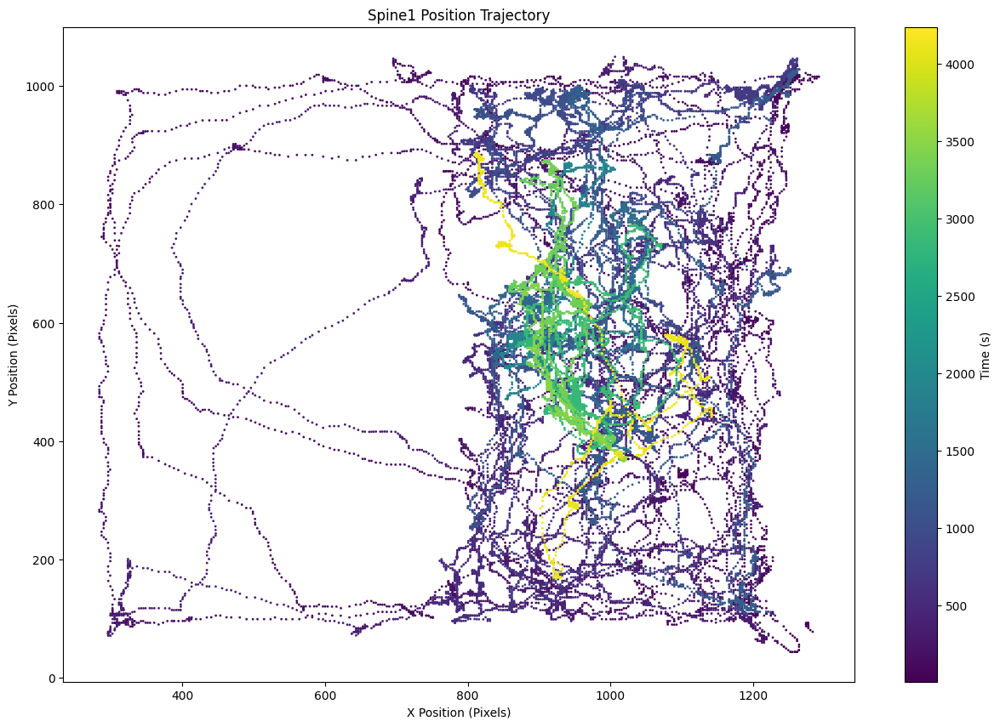

In [6]:
plt.figure(figsize=(15, 10))

x = name_to_data["spine1"][:, 0]
y = name_to_data["spine1"][:, 1]
timestamps = name_to_timestamps["spine1"]

sc = plt.scatter(x, y, c=timestamps, cmap='viridis', s=1)
plt.xlabel('X Position (Pixels)')
plt.ylabel('Y Position (Pixels)')
plt.title('Spine1 Position Trajectory')
plt.colorbar(sc, label='Time (s)')

Animate SLEAP Pose Estimation

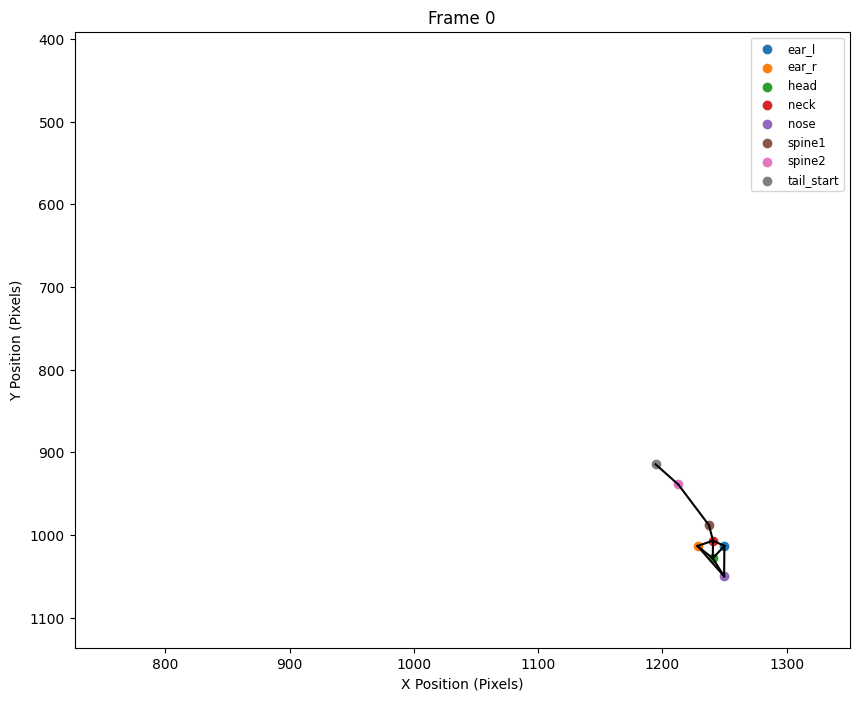

In [7]:
from IPython.display import HTML

import matplotlib.animation as animation

# Sample a subset of frames for faster animation
num_frames = min(len(next(iter(name_to_data.values()))), 300)  # Use all frames or limit to 300
frame_indices = np.arange(num_frames)

# Set axis limits (use consistent limits for all frames)
# Calculate data bounds with some margin
all_x_values = np.concatenate([data[frame_indices, 0] for data in name_to_data.values()])
all_y_values = np.concatenate([data[frame_indices, 1] for data in name_to_data.values()])

x_min, x_max = np.min(all_x_values), np.max(all_x_values)
y_min, y_max = np.min(all_y_values), np.max(all_y_values)

# Add 10% margin around the data
x_margin = (x_max - x_min) * 0.1
y_margin = (y_max - y_min) * 0.1

# Create a figure
fig, ax = plt.subplots(figsize=(10, 8))

# Set up a function to animate each frame
def animate(frame_idx):
    ax.clear()
    
    # Plot each node (body part) at the current frame
    for name, data in name_to_data.items():
        ax.scatter(data[frame_idx, 0], data[frame_idx, 1], label=name)
    
    # Plot the edges connecting the nodes
    for edge in edges:
        data1 = name_to_data[nodes[edge[0]]]
        data2 = name_to_data[nodes[edge[1]]]
        ax.plot([data1[frame_idx, 0], data2[frame_idx, 0]], 
                [data1[frame_idx, 1], data2[frame_idx, 1]], color="black")
    
    ax.set_xlim(x_min - x_margin, x_max + x_margin)
    ax.set_ylim(y_min - y_margin, y_max + y_margin)
    ax.set_title(f'Frame {frame_idx}')
    ax.set_xlabel('X Position (Pixels)')
    ax.set_ylabel('Y Position (Pixels)')
    ax.legend(loc='upper right', fontsize='small')
    ax.invert_yaxis()  # Invert y-axis to match image coordinates
    
    return ax

# Create the animation
ani = animation.FuncAnimation(fig, animate, frames=frame_indices, interval=50, blit=False)

# Display the animation
HTML(ani.to_jshtml())

# Audio-Visual Example Session

In [8]:
nwbfile_path = "/Volumes/T7/CatalystNeuro/Schneider/conversion_nwb/corredera_2025/sub-m14_vr_threat_ses-2024-12-12.nwb"
with NWBHDF5IO(nwbfile_path, 'r') as io:
    nwbfile = io.read()
    display(nwbfile)

Data type,float32
Shape,"(686505473, 4)"
Array size,10.23 GiB
Chunk shape,"(1581, 4)"
Compression,gzip
Compression opts,4
Compression ratio,1.6121223578169703
Data type,float64
Shape,"(686505473,)"
Array size,5.11 GiB
Chunk shape,"(1250000,)"


Retrieve Audio Recording, Audiovisual Stimulus, Ephys recording and sorting, and Pose Estimation

In [9]:
with NWBHDF5IO(nwbfile_path, 'r') as io:
    nwbfile = io.read()

    # Ephys Recording
    raw_electrical_series = nwbfile.acquisition["ElectricalSeriesRaw"]
    raw_starting_time = raw_electrical_series.starting_time
    plot_start_time = raw_starting_time
    plot_stop_time = raw_starting_time + 1  # Plot for 1 second
    raw_fs = raw_electrical_series.rate
    raw_to_uV = raw_electrical_series.conversion * 1e6
    raw_electrical_series_in_uV = raw_electrical_series.data[:int(raw_fs), 0] * raw_to_uV
    raw_electrical_series_timestamps = np.arange(0, len(raw_electrical_series_in_uV)) / raw_fs + raw_starting_time
    processed_electrical_series = nwbfile.processing["ecephys"].data_interfaces["Processed"].electrical_series["ElectricalSeriesProcessed"]
    processed_electrical_series_starting_time = processed_electrical_series.starting_time
    processed_fs = processed_electrical_series.rate
    processed_to_uV = processed_electrical_series.conversion * 1e6
    processed_electrical_series_in_uV = processed_electrical_series.data[:int(processed_fs), 0] * processed_to_uV
    processed_electrical_series_timestamps = np.arange(0, len(processed_electrical_series_in_uV)) / processed_fs + processed_electrical_series_starting_time

    # Ephys Sorting
    units_df = nwbfile.units.to_dataframe()
    units_df_good = units_df[(units_df['quality'] == 'good') & (units_df["KSLabel"] == "good")]
    units_df_ch13 = units_df_good[units_df_good['ch'] == 13]
    spike_times_per_unit = []
    for unit, row in units_df_ch13.iterrows():
        spike_times = row['spike_times'][(row['spike_times'] >= plot_start_time) & (row['spike_times'] < plot_stop_time)]
        spike_times_per_unit.append(spike_times)
    
    # Audio Recording
    audio_start_index = bisect_left(nwbfile.acquisition['AudioRecording'].timestamps, plot_start_time)
    audio_stop_index = bisect_left(nwbfile.acquisition['AudioRecording'].timestamps, plot_stop_time)
    audio_timestamps = nwbfile.acquisition['AudioRecording'].timestamps[audio_start_index:audio_stop_index]
    audio_data = nwbfile.acquisition['AudioRecording'].data[audio_start_index:audio_stop_index, :]

    # Audio Stimulus
    stimulus_1_data = nwbfile.stimulus_template["sound1-owl-calls"].data[:]
    stimulus_1_rate = nwbfile.stimulus_template["sound1-owl-calls"].rate
    stimulus_2_data = nwbfile.stimulus_template["sound2_crescendo_noise_gain70"].data[:]
    stimulus_2_rate = nwbfile.stimulus_template["sound2_crescendo_noise_gain70"].rate
    stimulus_3_data = nwbfile.stimulus_template["sound3_branco_3_upsweeps"].data[:]
    stimulus_3_rate = nwbfile.stimulus_template["sound3_branco_3_upsweeps"].rate
    audio_stimulus_df = nwbfile.stimulus["AudioStimulus"].to_dataframe()
    visual_stimulus_df = nwbfile.stimulus["VisualStimulus"].to_dataframe()

    # Pose Estimation
    pose_estimation_series = nwbfile.processing["SLEAP_VIDEO_000_m14_vr_threat_2024-12-12_001_CamFlir1_20241212_120339"].data_interfaces["track=untracked"].pose_estimation_series
    name_to_data = {name: series.data[:] for name, series in pose_estimation_series.items()}
    name_to_timestamps = {name: series.timestamps[:] for name, series in pose_estimation_series.items()}
    edges = nwbfile.processing["SLEAP_VIDEO_000_m14_vr_threat_2024-12-12_001_CamFlir1_20241212_120339"].data_interfaces["track=untracked"].skeleton.edges[:]
    nodes = nwbfile.processing["SLEAP_VIDEO_000_m14_vr_threat_2024-12-12_001_CamFlir1_20241212_120339"].data_interfaces["track=untracked"].skeleton.nodes[:]

Plot Ephys and Audio data

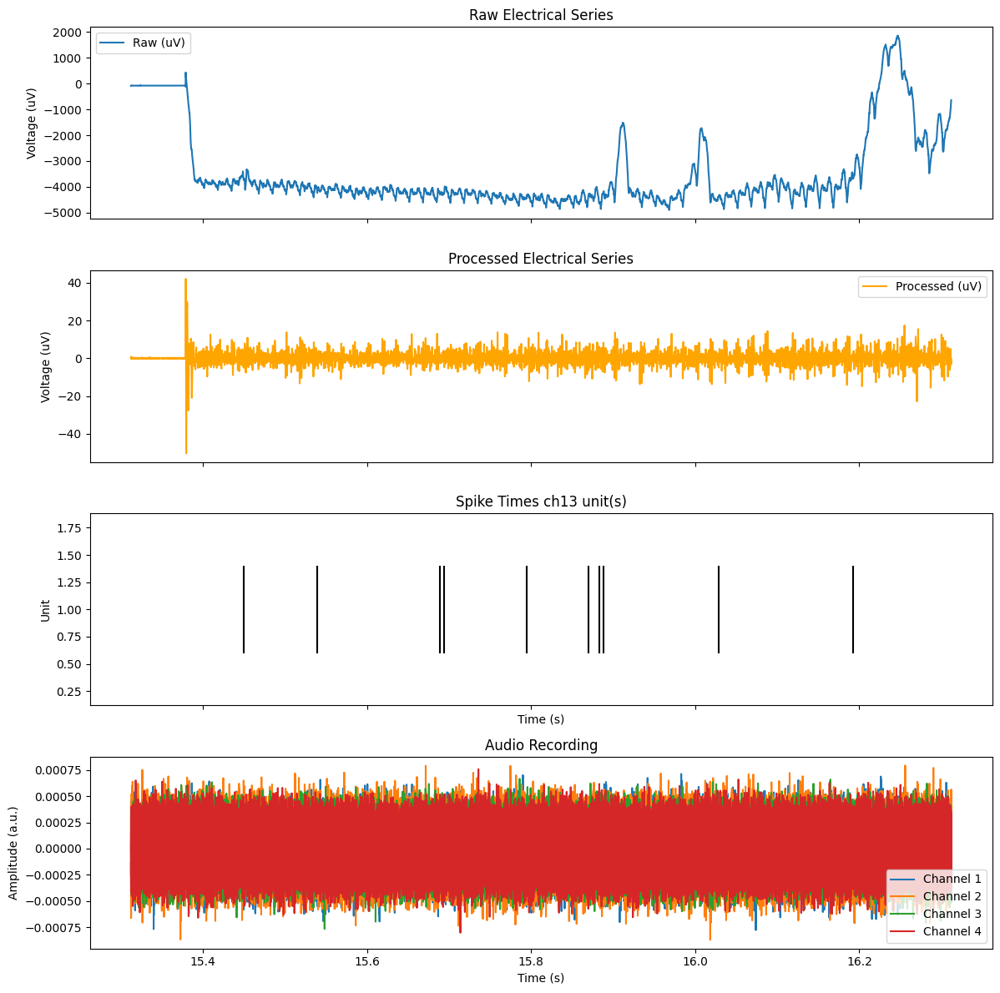

In [10]:
fig, axs = plt.subplots(4, 1, figsize=(12, 12), sharex=True)

axs[0].plot(raw_electrical_series_timestamps, raw_electrical_series_in_uV, label='Raw (uV)')
axs[0].set_ylabel('Voltage (uV)')
axs[0].set_title('Raw Electrical Series')
axs[0].legend()

axs[1].plot(processed_electrical_series_timestamps, processed_electrical_series_in_uV, label='Processed (uV)', color='orange')
axs[1].set_ylabel('Voltage (uV)')
axs[1].set_title('Processed Electrical Series')
axs[1].legend()

axs[2].eventplot(spike_times_per_unit, colors='k', linelengths=0.8)
axs[2].set_xlabel('Time (s)')
axs[2].set_ylabel('Unit')
axs[2].set_title('Spike Times ch13 unit(s)')

for ch in range(audio_data.shape[1]):
    axs[3].plot(audio_timestamps, audio_data[:, ch], label=f"Channel {ch+1}")
axs[3].set_title('Audio Recording')
axs[3].set_xlabel('Time (s)')
axs[3].set_ylabel('Amplitude (a.u.)')
axs[3].legend()

plt.tight_layout()
plt.show()

Plot Audio and Visual Stimulus

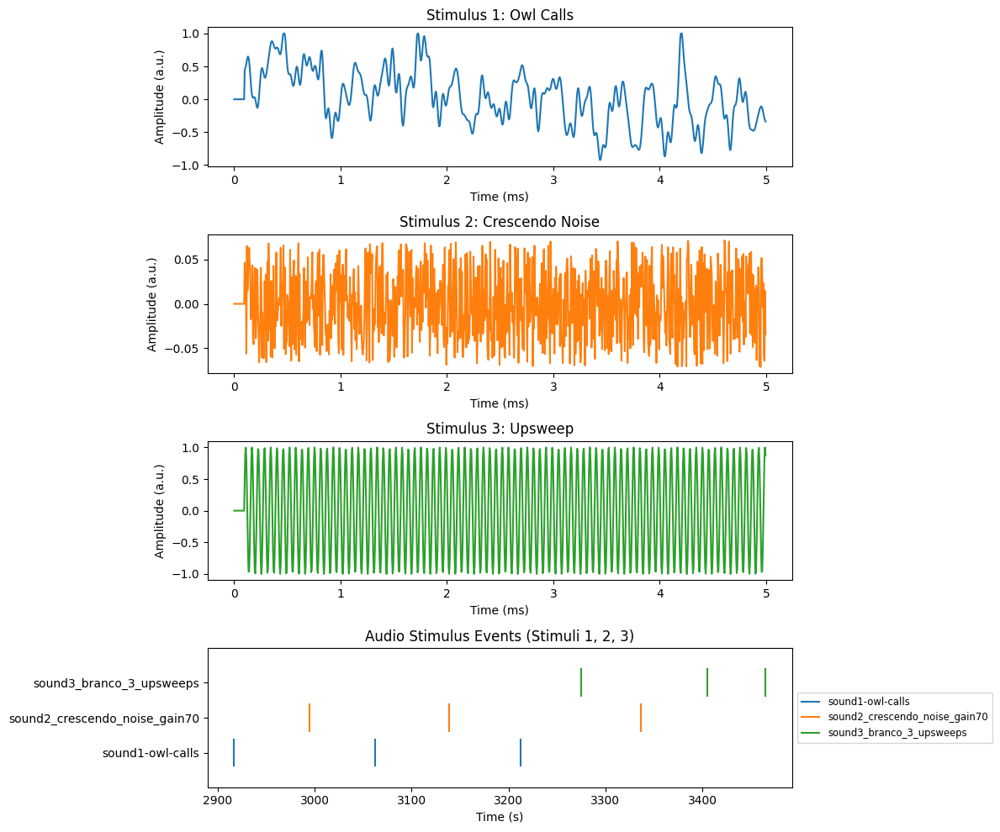

,onset_time,peak_expansion_time,offset_time,post_stim_interval_sec,win,screenRect,width_px,height_px,ifi,sigma,...,width_deg,height_deg,radius_init_px,discSize_init_px,expansionIncrement_degpf,expansionIncrement_pxpf,discSize_end_px,discTexture,texRect,dstRects
id,,,,,,,,,,,,,,,,,,,,,
0,2737.821855,2742.428757,2743.441712,1,10,"[0, 0, 1920, 1080]",1920,1080,0.016949,3,...,53.424442,30.051249,47,94,0.189831,6.822244,1696.302228,11,"[0, 0, 94, 94]","[913, 493, 1007, 587]"


In [11]:
stimuli = [
    (stimulus_1_data, stimulus_1_rate, "Stimulus 1: Owl Calls"),
    (stimulus_2_data, stimulus_2_rate, "Stimulus 2: Crescendo Noise"),
    (stimulus_3_data, stimulus_3_rate, "Stimulus 3: Upsweep")
]

window_ms = 5  # milliseconds to display

# Use the same colors as the lower plot
colors = plt.cm.tab10.colors
stimulus_names_to_plot = [
    "sound1-owl-calls",
    "sound2_crescendo_noise_gain70",
    "sound3_branco_3_upsweeps",
]
name_to_color = {name: colors[i % len(colors)] for i, name in enumerate(stimulus_names_to_plot)}

fig, axs = plt.subplots(4, 1, figsize=(12, 10), sharex=False)

# Plot the three stimulus waveforms
for ax, (data, rate, title), name in zip(axs[:3], stimuli, stimulus_names_to_plot):
    n_samples = int(window_ms * 1e-3 * rate)
    t = np.arange(n_samples) / rate
    ax.plot(t * 1e3, data[:n_samples], color=name_to_color[name])  # convert time to ms
    ax.set_title(title)
    ax.set_xlabel("Time (ms)")
    ax.set_ylabel("Amplitude (a.u.)")

# Plot event times from the audio stimulus table, but only for stimuli 1, 2, and 3
ax = axs[3]
for i, name in enumerate(stimulus_names_to_plot):
    times = audio_stimulus_df[audio_stimulus_df['stimulus_name'] == name]['presentation_time'].values
    ax.eventplot(times, lineoffsets=i, colors=[name_to_color[name]], linelengths=0.8, label=name)

ax.set_title("Audio Stimulus Events (Stimuli 1, 2, 3)")
ax.set_xlabel("Time (s)")
ax.set_yticks(range(len(stimulus_names_to_plot)))
ax.set_yticklabels(stimulus_names_to_plot)
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize='small')

plt.tight_layout()
plt.show()

display(visual_stimulus_df)

Plot Pose Estimation

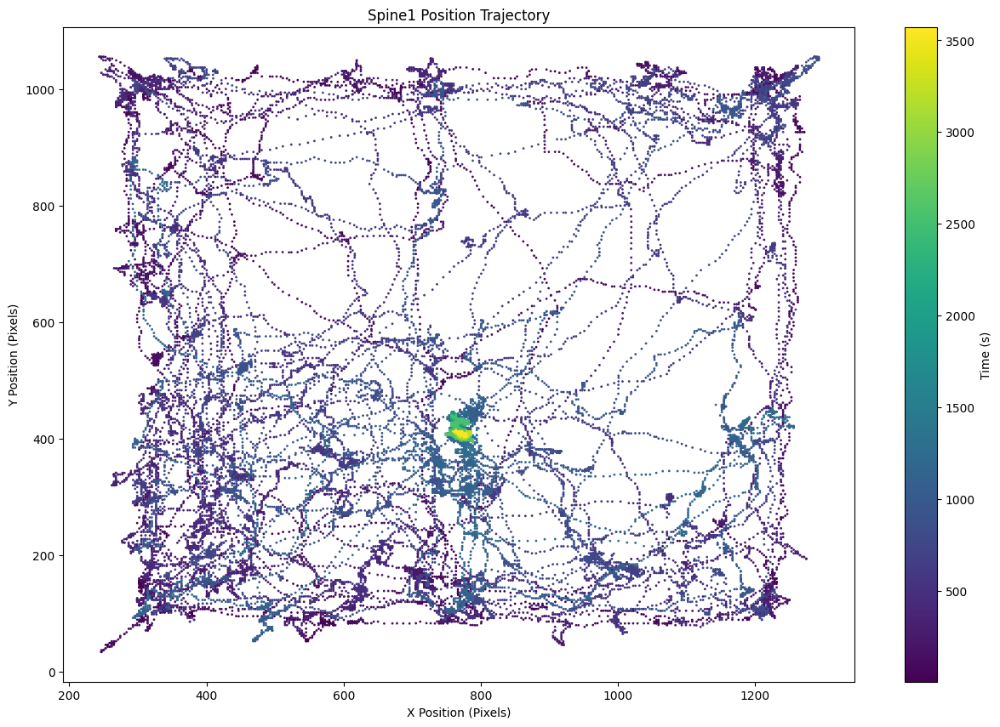

In [12]:
plt.figure(figsize=(15, 10))

x = name_to_data["spine1"][:, 0]
y = name_to_data["spine1"][:, 1]
timestamps = name_to_timestamps["spine1"]

sc = plt.scatter(x, y, c=timestamps, cmap='viridis', s=1)
plt.xlabel('X Position (Pixels)')
plt.ylabel('Y Position (Pixels)')
plt.title('Spine1 Position Trajectory')
plt.colorbar(sc, label='Time (s)')

Animate SLEAP Pose Estimation

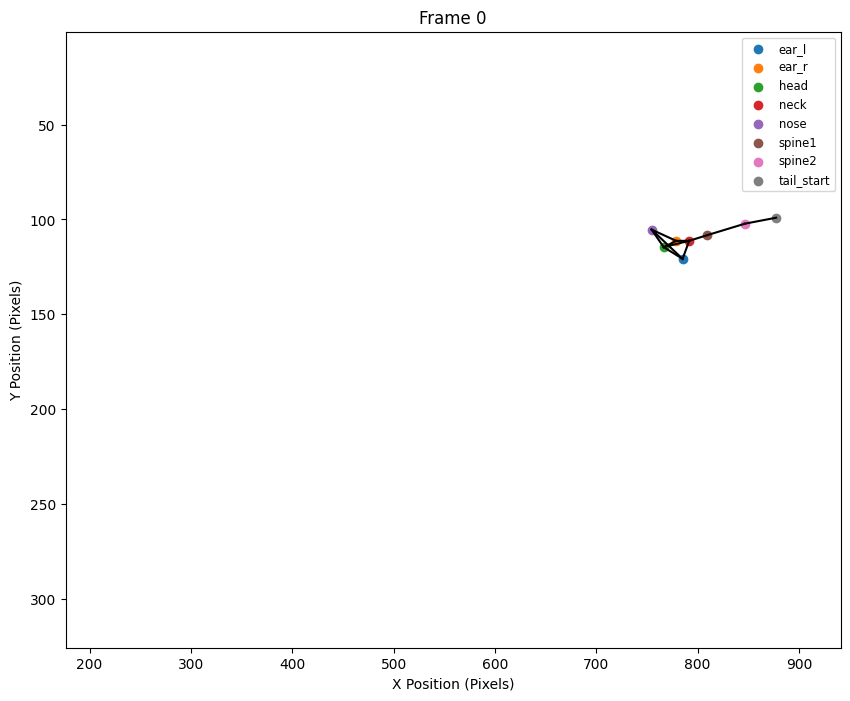

In [13]:
from IPython.display import HTML

import matplotlib.animation as animation

# Sample a subset of frames for faster animation
num_frames = min(len(next(iter(name_to_data.values()))), 300)  # Use all frames or limit to 300
frame_indices = np.arange(num_frames)

# Set axis limits (use consistent limits for all frames)
# Calculate data bounds with some margin
all_x_values = np.concatenate([data[frame_indices, 0] for data in name_to_data.values()])
all_y_values = np.concatenate([data[frame_indices, 1] for data in name_to_data.values()])

x_min, x_max = np.min(all_x_values), np.max(all_x_values)
y_min, y_max = np.min(all_y_values), np.max(all_y_values)

# Add 10% margin around the data
x_margin = (x_max - x_min) * 0.1
y_margin = (y_max - y_min) * 0.1

# Create a figure
fig, ax = plt.subplots(figsize=(10, 8))

# Set up a function to animate each frame
def animate(frame_idx):
    ax.clear()
    
    # Plot each node (body part) at the current frame
    for name, data in name_to_data.items():
        ax.scatter(data[frame_idx, 0], data[frame_idx, 1], label=name)
    
    # Plot the edges connecting the nodes
    for edge in edges:
        data1 = name_to_data[nodes[edge[0]]]
        data2 = name_to_data[nodes[edge[1]]]
        ax.plot([data1[frame_idx, 0], data2[frame_idx, 0]], 
                [data1[frame_idx, 1], data2[frame_idx, 1]], color="black")
    
    ax.set_xlim(x_min - x_margin, x_max + x_margin)
    ax.set_ylim(y_min - y_margin, y_max + y_margin)
    ax.set_title(f'Frame {frame_idx}')
    ax.set_xlabel('X Position (Pixels)')
    ax.set_ylabel('Y Position (Pixels)')
    ax.legend(loc='upper right', fontsize='small')
    ax.invert_yaxis()  # Invert y-axis to match image coordinates
    
    return ax

# Create the animation
ani = animation.FuncAnimation(fig, animate, frames=frame_indices, interval=50, blit=False)

# Display the animation
HTML(ani.to_jshtml())